<h1> Important imports </h1>

In [ ]:
! pip install tf_explain
! pip install keras_preprocessing
! pip install efficientnet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 1.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 882.1 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 2.2 MB/s eta 0:00:00


In [ ]:
!pip install keras_efficientnets

In [ ]:
! mkdir ~/.kaggle

In [ ]:
! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
! kaggle competitions download -c state-farm-distracted-driver-detection

100% 3.99G/4.00G [00:40<00:00, 126MB/s]
100% 4.00G/4.00G [00:40<00:00, 106MB/s]


In [ ]:
! unzip state-farm-distracted-driver-detection

Streaming output truncated to the last 5000 lines.
  inflating: imgs/train/c7/img_56661.jpg  
  inflating: imgs/train/c7/img_56699.jpg  
  inflating: imgs/train/c7/img_56717.jpg  
  inflating: imgs/train/c7/img_56724.jpg  
  inflating: imgs/train/c7/img_56768.jpg  
  inflating: imgs/train/c7/img_56779.jpg  
  inflating: imgs/train/c7/img_56849.jpg  
  inflating: imgs/train/c7/img_56899.jpg  
  inflating: imgs/train/c7/img_56938.jpg  
  inflating: imgs/train/c7/img_5706.jpg  
  inflating: imgs/train/c7/img_57076.jpg  
  inflating: imgs/train/c7/img_57122.jpg  
  inflating: imgs/train/c7/img_57137.jpg  
  inflating: imgs/train/c7/img_5715.jpg  
  inflating: imgs/train/c7/img_57278.jpg  
  inflating: imgs/train/c7/img_57321.jpg  
  inflating: imgs/train/c7/img_57345.jpg  
  inflating: imgs/train/c7/img_57355.jpg  
  inflating: imgs/train/c7/img_5741.jpg  
  inflating: imgs/train/c7/img_57433.jpg  
  inflating: imgs/train/c7/img_5753.jpg  
  inflating: imgs/train/c7/img_57559.jpg  
  infla

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import cv2 #opencv library
import glob
import matplotlib.pyplot as plt  #plotting library
import matplotlib.image as mpimg
from sklearn.model_selection import train_test_split
import tensorflow as tf
import random
from skimage import io
from keras.callbacks import EarlyStopping
from PIL import Image
from tqdm import tqdm
import h5py
import seaborn as sns
import os
import random as rnd
import secrets
import plotly.express as px
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from tf_explain.core.activations import ExtractActivations
from tf_explain.core.grad_cam import GradCAM
from tensorflow.keras.layers import Input, Conv2D,GlobalAveragePooling2D , MaxPooling2D, AveragePooling2D, Concatenate, Flatten, Dense
from tensorflow.keras.applications import ResNet50
from keras import layers
from keras import models
from keras import optimizers
from keras.models import Sequential, Model
from tensorflow.keras.applications.resnet50 import preprocess_input
from keras.preprocessing.image import ImageDataGenerator
from keras_preprocessing.image import img_to_array, load_img
from efficientnet.tfkeras import EfficientNetB0 as Net
from efficientnet.tfkeras import center_crop_and_resize, preprocess_input
from keras.layers import Convolution2D,Conv2D, MaxPooling2D, Flatten, Dense, Dropout,BatchNormalization
print(os.listdir("/content/imgs"))

['train', 'test']


<h1> Setting directory paths </h1>

In [ ]:
df_train_full = pd.read_csv('/content/driver_imgs_list.csv')
df_train_full['path']= '/content/imgs/train/' + df_train_full['classname']+ '/' +df_train_full['img']
df_test = '/content/imgs/test'
train_dir='/content/imgs/train/'

In [ ]:
classes = {   'c0' : "safe_driving",
                      'c1' : "texting-right",
                      'c2' : "talking_on_the_phone-right",
                      'c3' : "texting-left",
                      'c4' : "talking_on_the_phone-left",
                      'c5' : "operating_the_radio",
                      'c6' : "drinking",
                      'c7' : "reaching_behind",
                      'c8' : "hair-and-makeup",
                      'c9' : "talking_to_passenger"}
classes

{'c0': 'safe_driving',
 'c1': 'texting-right',
 'c2': 'talking_on_the_phone-right',
 'c3': 'texting-left',
 'c4': 'talking_on_the_phone-left',
 'c5': 'operating_the_radio',
 'c6': 'drinking',
 'c7': 'reaching_behind',
 'c8': 'hair-and-makeup',
 'c9': 'talking_to_passenger'}

In [ ]:
df_train_full.head()

,subject,classname,img,path
0,p002,c0,img_44733.jpg,/content/imgs/train/c0/img_44733.jpg
1,p002,c0,img_72999.jpg,/content/imgs/train/c0/img_72999.jpg
2,p002,c0,img_25094.jpg,/content/imgs/train/c0/img_25094.jpg
3,p002,c0,img_69092.jpg,/content/imgs/train/c0/img_69092.jpg
4,p002,c0,img_92629.jpg,/content/imgs/train/c0/img_92629.jpg


In [ ]:
num_samples_to_use = int(0.50 * len(df_train_full))
subset_indices = random.sample(range(len(df_train_full)), num_samples_to_use)
df_train = df_train_full.iloc[subset_indices]

# Print the number of samples in the 25% subset
print("Number of samples in 25% subset:", len(df_train))

Number of samples in 25% subset: 11212


In [ ]:
print("Number of image files for in training dataset: ",len(df_train))
print("Number of classes: ",len(df_train['classname'].value_counts()))

Number of image files for in training dataset:  11212
Number of classes:  10


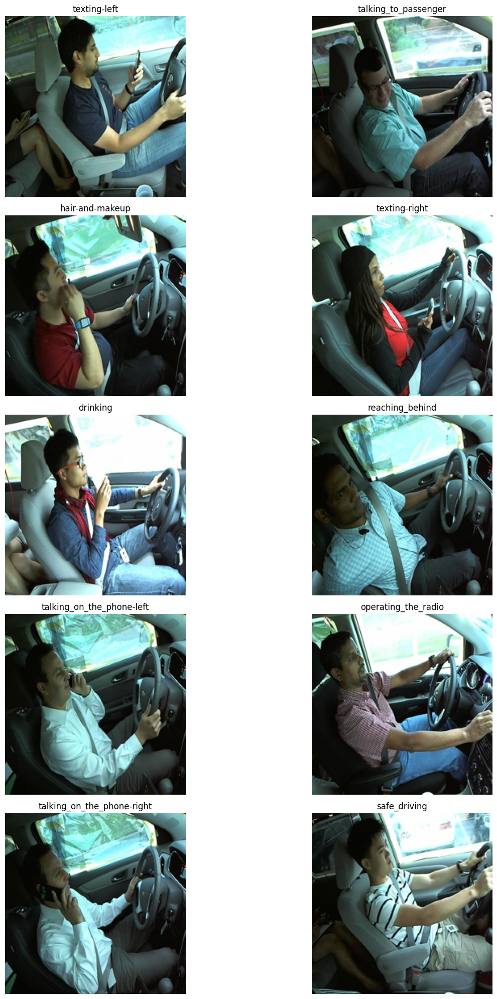

In [ ]:
plt.figure(figsize = (15,20))
for idx,i in enumerate(df_train.classname.unique()):
    plt.subplot(5,2,idx+1)
    df = df_train[df_train['classname'] ==i].reset_index(drop = True)
    image_path = df.loc[rnd.randint(0, len(df))-1,'path']
    img = Image.open(image_path)
    img = img.resize((224,224))
    plt.imshow(img)
    plt.axis('off')
    plt.title(classes[i])
plt.tight_layout()
plt.show()

In [ ]:
# Create the count plot
fig = px.histogram(df_train, x='classname', color_discrete_sequence=['blue'])  # Change the color here

# Set the layout
fig.update_layout(
    title='Driver Class Distribution',
    title_font=dict(family='Arial', size=24),  # Change the font family and size for the title
    xaxis_title='Driver classes',
    xaxis=dict(title_font=dict(family='Arial', size=18)),  # Change the font family and size for x-axis label
    yaxis_title='Count',
    yaxis=dict(title_font=dict(family='Arial', size=14)),  # Change the font family and size for y-axis label
    autosize=False,
    width=800,
    height=600,
    margin=dict(l=50, r=50, t=100, b=50),
)



# Show the plot
fig.show()

In [ ]:
widths, heights = [], []

for path in tqdm(df_train["path"]):
    width, height = Image.open(path).size
    widths.append(width)
    heights.append(height)

df_train["width"] = widths
df_train["height"] = heights
df_train["dimension"] = df_train["width"] * df_train["height"]

100%|██████████| 11212/11212 [00:00<00:00, 12631.88it/s]
<ipython-input-18-45a28a193c6a>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-18-45a28a193c6a>:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-18-45a28a193c6a>:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

In [ ]:
df_train

,subject,classname,img,path,width,height,dimension
3717,p016,c3,img_88171.jpg,/content/imgs/train/c3/img_88171.jpg,640,480,307200
3277,p015,c9,img_12651.jpg,/content/imgs/train/c9/img_12651.jpg,640,480,307200
7893,p024,c8,img_67529.jpg,/content/imgs/train/c8/img_67529.jpg,640,480,307200
17256,p056,c3,img_34233.jpg,/content/imgs/train/c3/img_34233.jpg,640,480,307200
12796,p047,c1,img_75568.jpg,/content/imgs/train/c1/img_75568.jpg,640,480,307200
...,...,...,...,...,...,...,...
19142,p064,c6,img_71777.jpg,/content/imgs/train/c6/img_71777.jpg,640,480,307200
3087,p015,c7,img_66737.jpg,/content/imgs/train/c7/img_66737.jpg,640,480,307200
10868,p041,c1,img_61405.jpg,/content/imgs/train/c1/img_61405.jpg,640,480,307200
15199,p050,c8,img_26672.jpg,/content/imgs/train/c8/img_26672.jpg,640,480,307200


<h1> Create training / test data </h1>

**Augmentation**


In [ ]:
def increase_brightness(img, value):
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)

    lim = 255 - value
    v[v > lim] = 255
    v[v <= lim] += value

    final_hsv = cv2.merge((h, s, v))
    img = cv2.cvtColor(final_hsv, cv2.COLOR_HSV2BGR)
    return img

def change_contrast(img, level):
    img = Image.fromarray(img.astype('uint8'))
    factor = (259 * (level + 255)) / (255 * (259 - level))
    def contrast(c):
        return 128 + factor * (c - 128)
    return np.array(img.point(contrast))

def preprocessing(img):
    img_arr = np.array(img)

    x = random.randint(0, 1)

    if x == 0:
        img_arr = increase_brightness(img_arr, secrets.randbelow(26))
        img_arr = change_contrast(img_arr, secrets.randbelow(51))
    else:
        img_arr = change_contrast(img_arr, secrets.randbelow(51))
        img_arr = increase_brightness(img_arr, secrets.randbelow(26))

    return img_arr


datagen = ImageDataGenerator(
        rotation_range = 5,
        width_shift_range = 0.03,
        height_shift_range = 0.03,
        shear_range = 0.03,
        zoom_range = 0.03,
        horizontal_flip = False,
        fill_mode = "nearest",
        validation_split = 0.2,
        preprocessing_function = preprocessing)

In [ ]:
X, y = df_train[['path', 'classname']], df_train['classname']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
trainGenerator_cnn = datagen.flow_from_dataframe(X_train,
                                         x_col='path',
                                         y_col='classname',
                                        target_size=(240,240),
                                        batch_size=32,
                                        subset='training',shuffle=False)

validationGenerator_cnn = datagen.flow_from_dataframe(X_test,
                                          x_col='path',
                                         y_col='classname',
                                        target_size=(240,240),
                                        batch_size=32,
                                        subset='validation',shuffle=False)

Found 6279 validated image filenames belonging to 10 classes.
Found 672 validated image filenames belonging to 10 classes.


In [ ]:
 def orig():
    model = models.Sequential()

        # Convolutional layers
    model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(240,240,3)))
    model.add(layers.MaxPooling2D((2, 2)))

    model.add(layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))

    model.add(layers.Conv2D(128, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))

        # Flatten the output from convolutional layers to pass to dense layers
    model.add(layers.Flatten())

        # Fully connected (Dense) layers
    model.add(layers.Dense(256, activation='relu'))
    model.add(layers.Dense(10, activation='softmax'))

In [ ]:
def create_model_v2():
    # Optimised Vanilla CNN model
    model = Sequential()

    ## CNN 1
    model.add(Conv2D(32,(3,3),activation='relu',input_shape=(240, 240, 3)))
    model.add(BatchNormalization())
    model.add(Conv2D(32,(3,3),activation='relu',padding='same'))
    model.add(BatchNormalization(axis = 3))
    model.add(MaxPooling2D(pool_size=(2,2),padding='same'))
    model.add(Dropout(0.3))

    ## CNN 2
    model.add(Conv2D(64,(3,3),activation='relu',padding='same'))
    model.add(BatchNormalization())
    model.add(Conv2D(64,(3,3),activation='relu',padding='same'))
    model.add(BatchNormalization(axis = 3))
    model.add(MaxPooling2D(pool_size=(2,2),padding='same'))
    model.add(Dropout(0.3))

    ## CNN 3
    model.add(Conv2D(128,(3,3),activation='relu',padding='same'))
    model.add(BatchNormalization())
    model.add(Conv2D(128,(3,3),activation='relu',padding='same'))
    model.add(BatchNormalization(axis = 3))
    model.add(MaxPooling2D(pool_size=(2,2),padding='same'))
    model.add(Dropout(0.5))

    ## CNN 4
    model.add(Conv2D(256,(3,3),activation='relu',padding='same'))
    model.add(BatchNormalization())
    model.add(Conv2D(256,(3,3),activation='relu',padding='same'))
    model.add(BatchNormalization(axis = 3))
    model.add(MaxPooling2D(pool_size=(2,2),padding='same'))
    model.add(Dropout(0.5))

    ## Output
    model.add(Flatten())
    model.add(Dense(512,activation='relu'))
    model.add(BatchNormalization())
    model.add(Dropout(0.5))
    model.add(Dense(128,activation='relu'))
    model.add(Dropout(0.25))
    model.add(Dense(10,activation='softmax'))

    return model

In [ ]:
model=create_model_v2()
model.compile(loss='categorical_crossentropy', optimizer="adam", metrics=['accuracy'])
callbacks = [EarlyStopping(monitor='val_acc',patience=5)]
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 238, 238, 32)      896       
                                                                 
 batch_normalization (BatchN  (None, 238, 238, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 238, 238, 32)      9248      
                                                                 
 batch_normalization_1 (Batc  (None, 238, 238, 32)     128       
 hNormalization)                                                 
                                                                 
 max_pooling2d (MaxPooling2D  (None, 119, 119, 32)     0         
 )                                                               
                                                        

In [ ]:
for batch_images, batch_labels in trainGenerator_cnn:
    # 'batch_images' is a batch of input images
    # 'batch_labels' is a batch of corresponding labels

    # Print batch shape and label values
    print("Batch images shape:", batch_images.shape)
    print("Batch labels:", batch_labels)

    # Break the loop if you want to print only the first batch
    break

Batch images shape: (32, 240, 240, 3)
Batch labels: [[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0

In [ ]:
history_cnn_model = model.fit(
      trainGenerator_cnn,
     validation_data=validationGenerator_cnn,
      epochs=24,
      verbose=1)

Epoch 1/24
197/197 [==============================] - 165s 722ms/step - loss: 1.7716 - accuracy: 0.4243 - val_loss: 1.1025 - val_accuracy: 0.6369
Epoch 2/24
197/197 [==============================] - 140s 712ms/step - loss: 0.8033 - accuracy: 0.7387 - val_loss: 0.5225 - val_accuracy: 0.8274
Epoch 3/24
197/197 [==============================] - 138s 702ms/step - loss: 0.5032 - accuracy: 0.8344 - val_loss: 0.2560 - val_accuracy: 0.9137
Epoch 4/24
197/197 [==============================] - 139s 705ms/step - loss: 0.3671 - accuracy: 0.8798 - val_loss: 0.3764 - val_accuracy: 0.8884
Epoch 5/24
197/197 [==============================] - 140s 715ms/step - loss: 0.3495 - accuracy: 0.8885 - val_loss: 0.4762 - val_accuracy: 0.8750
Epoch 6/24
197/197 [==============================] - 138s 701ms/step - loss: 0.2886 - accuracy: 0.9051 - val_loss: 0.1760 - val_accuracy: 0.9509
Epoch 7/24
197/197 [==============================] - 139s 707ms/step - loss: 0.4711 - accuracy: 0.8492 - val_loss: 0.4740 -

In [ ]:
preds_val = model.predict(validationGenerator_cnn)
preds_val

21/21 [==============================] - 14s 686ms/step


array([[1.2780088e-06, 1.9137707e-08, 2.0718603e-10, ..., 1.6755706e-09,
        3.1835841e-06, 1.0419375e-07],
       [6.2834249e-07, 1.6686224e-08, 2.5960006e-10, ..., 2.3660096e-09,
        5.0768795e-10, 1.8222555e-06],
       [2.7247868e-02, 2.6641002e-05, 1.4438747e-02, ..., 4.3774548e-07,
        1.6501056e-03, 2.2826616e-03],
       ...,
       [1.8162591e-11, 1.0000000e+00, 4.7378665e-09, ..., 1.1570808e-12,
        1.4261660e-08, 2.9084421e-11],
       [1.2930542e-04, 9.9978215e-01, 6.1400860e-06, ..., 3.2838832e-09,
        6.0433999e-06, 2.8011888e-08],
       [8.7704528e-09, 3.0769380e-14, 2.5756417e-08, ..., 9.6995384e-11,
        9.8571581e-06, 6.2460763e-06]], dtype=float32)

In [ ]:
predicted_labels = np.argmax(preds_val, axis=1)
predicted_labels

array([3, 5, 4, 2, 1, 6, 4, 9, 5, 7, 2, 6, 6, 9, 5, 8, 3, 4, 1, 6, 4, 9,
       9, 2, 3, 0, 2, 6, 7, 0, 9, 1, 3, 0, 1, 9, 4, 6, 5, 7, 0, 5, 1, 4,
       5, 8, 7, 4, 8, 6, 7, 0, 0, 3, 4, 9, 1, 8, 1, 9, 7, 9, 1, 0, 8, 6,
       9, 0, 0, 0, 7, 7, 9, 7, 3, 2, 4, 2, 6, 5, 3, 1, 6, 5, 0, 7, 9, 8,
       1, 2, 3, 0, 8, 5, 1, 6, 5, 8, 3, 7, 1, 0, 2, 5, 4, 0, 0, 6, 0, 5,
       6, 3, 3, 7, 2, 3, 2, 5, 0, 0, 5, 3, 2, 0, 5, 8, 8, 0, 3, 0, 7, 2,
       9, 9, 0, 0, 4, 3, 4, 0, 6, 1, 2, 7, 0, 9, 4, 2, 7, 0, 3, 3, 0, 4,
       7, 2, 2, 3, 6, 6, 2, 5, 4, 6, 1, 4, 8, 5, 4, 0, 8, 9, 7, 9, 4, 0,
       0, 2, 5, 4, 4, 5, 6, 0, 1, 0, 1, 3, 0, 1, 5, 8, 7, 1, 9, 3, 1, 6,
       0, 9, 2, 6, 3, 0, 4, 0, 4, 7, 2, 1, 3, 7, 4, 3, 6, 6, 5, 9, 4, 6,
       0, 2, 3, 7, 1, 9, 4, 1, 0, 1, 9, 5, 8, 9, 0, 1, 5, 9, 7, 3, 5, 7,
       9, 4, 3, 5, 3, 8, 5, 1, 1, 4, 0, 7, 2, 7, 8, 5, 2, 3, 0, 2, 8, 7,
       8, 3, 2, 1, 7, 7, 3, 0, 1, 1, 5, 3, 9, 1, 5, 0, 8, 8, 5, 0, 3, 5,
       7, 2, 4, 2, 6, 0, 0, 3, 3, 6, 5, 7, 7, 1, 6,

In [ ]:
true_labels = validationGenerator_cnn.classes
true_labels

[3,
 5,
 4,
 2,
 1,
 6,
 4,
 9,
 5,
 7,
 2,
 6,
 6,
 9,
 5,
 8,
 3,
 4,
 1,
 6,
 0,
 9,
 9,
 2,
 3,
 0,
 2,
 6,
 7,
 9,
 9,
 1,
 3,
 0,
 1,
 9,
 4,
 6,
 5,
 7,
 0,
 5,
 1,
 4,
 5,
 8,
 7,
 4,
 8,
 6,
 7,
 0,
 0,
 3,
 4,
 9,
 1,
 8,
 1,
 9,
 7,
 9,
 1,
 0,
 8,
 6,
 9,
 0,
 0,
 0,
 7,
 7,
 9,
 7,
 3,
 2,
 4,
 2,
 6,
 5,
 3,
 1,
 6,
 5,
 0,
 7,
 9,
 8,
 1,
 2,
 3,
 0,
 8,
 5,
 1,
 6,
 5,
 8,
 3,
 7,
 1,
 0,
 2,
 5,
 4,
 0,
 0,
 6,
 5,
 5,
 6,
 3,
 3,
 7,
 2,
 3,
 2,
 5,
 0,
 0,
 5,
 3,
 2,
 0,
 5,
 8,
 8,
 0,
 3,
 0,
 7,
 2,
 9,
 9,
 0,
 0,
 4,
 3,
 4,
 0,
 6,
 1,
 2,
 7,
 0,
 9,
 4,
 2,
 7,
 0,
 3,
 3,
 0,
 4,
 7,
 2,
 2,
 3,
 6,
 6,
 2,
 5,
 4,
 1,
 1,
 4,
 8,
 5,
 4,
 0,
 8,
 9,
 7,
 9,
 4,
 0,
 0,
 2,
 5,
 4,
 4,
 5,
 6,
 0,
 1,
 0,
 1,
 3,
 0,
 1,
 5,
 8,
 7,
 1,
 9,
 3,
 1,
 6,
 0,
 9,
 2,
 6,
 3,
 0,
 4,
 0,
 4,
 7,
 2,
 1,
 3,
 7,
 4,
 3,
 2,
 6,
 5,
 9,
 4,
 6,
 0,
 2,
 3,
 7,
 1,
 9,
 4,
 1,
 0,
 1,
 9,
 5,
 8,
 9,
 0,
 1,
 5,
 8,
 7,
 3,
 5,
 7,
 9,
 4,
 3,
 5,
 8,
 8,
 5,
 1,


In [ ]:
print(confusion_matrix(true_labels, predicted_labels))
print(classification_report(true_labels, predicted_labels ))


[[78  0  0  0  1  0  0  0  0  0]
 [ 0 67  0  0  0  0  1  0  0  0]
 [ 0  0 62  0  0  0  1  0  0  0]
 [ 1  0  0 66  0  0  0  0  0  0]
 [ 1  0  0  1 63  0  0  0  1  1]
 [ 1  0  0  0  0 76  0  0  0  0]
 [ 0  1  0  0  0  0 68  0  1  0]
 [ 0  0  0  0  0  0  0 62  0  0]
 [ 0  0  0  1  0  0  0  0 51  1]
 [ 4  0  0  0  0  0  0  0  0 62]]
              precision    recall  f1-score   support

           0       0.92      0.99      0.95        79
           1       0.99      0.99      0.99        68
           2       1.00      0.98      0.99        63
           3       0.97      0.99      0.98        67
           4       0.98      0.94      0.96        67
           5       1.00      0.99      0.99        77
           6       0.97      0.97      0.97        70
           7       1.00      1.00      1.00        62
           8       0.96      0.96      0.96        53
           9       0.97      0.94      0.95        66

    accuracy                           0.97       672
   macro avg       

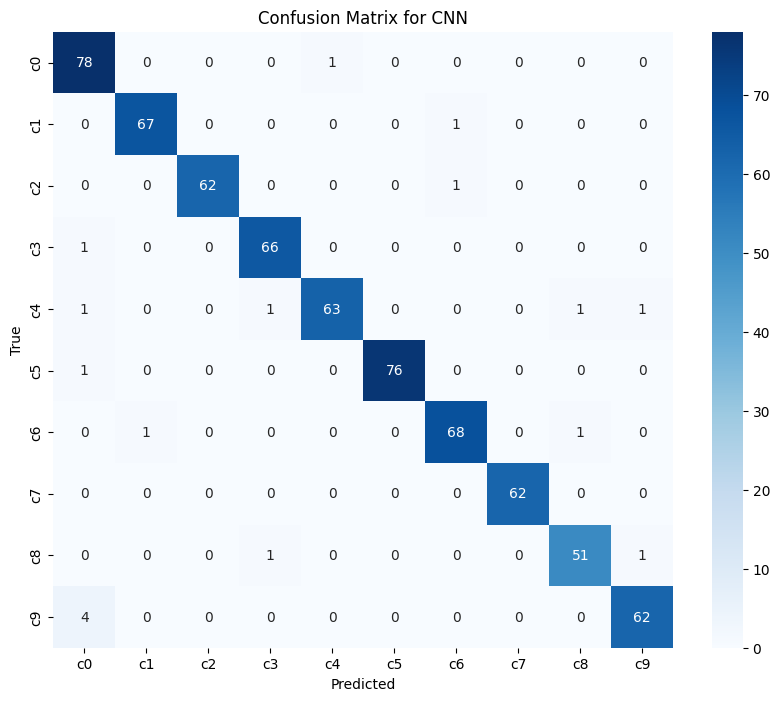

In [ ]:
# Create a heatmap of the confusion matrix
class_names = list(validationGenerator_cnn.class_indices.keys())
plt.figure(figsize=(10, 8))
sns.heatmap(confusion_matrix(true_labels, predicted_labels), annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix for CNN')
plt.show()

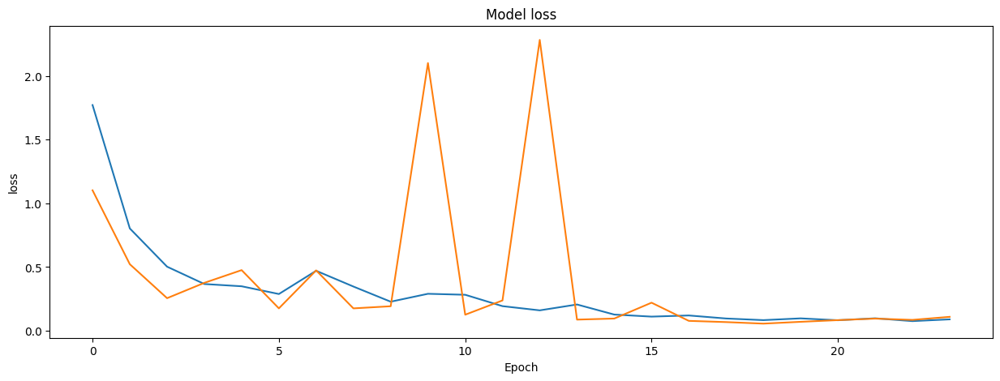

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_cnn_model.history['loss'])
plt.plot(history_cnn_model.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('Epoch')
plt.show()

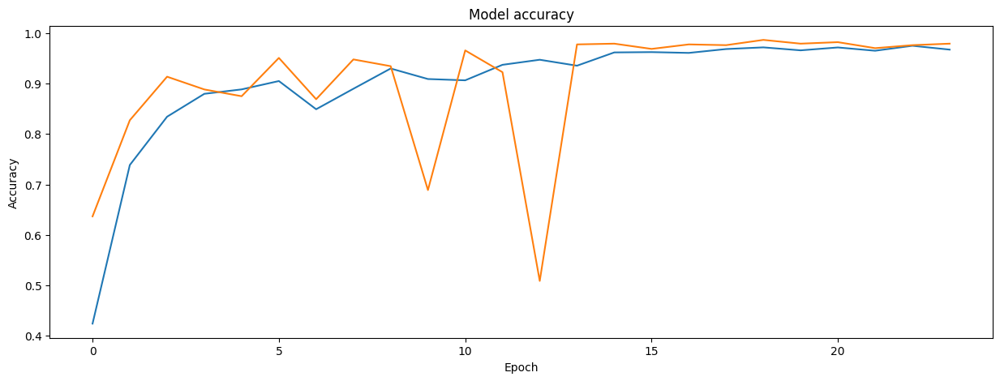

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_cnn_model.history['accuracy'])
plt.plot(history_cnn_model.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.show()

In [ ]:
dict_class = {'c0':0, 'c1':1, 'c2': 2, 'c3': 3, 'c4': 4, 'c5':5, 'c6': 6, 'c7':7, 'c8':8, 'c9':9}

In [ ]:
def gradcam_visualise(data, model, class_index):
    explainer = GradCAM()
    output = explainer.explain(data, model, class_index=class_index)
    return output

def activation_visualise(image, model, layers):
    explainer = ExtractActivations()
    output = explainer.explain([image], model, layers_name=layers)
    return output

In [ ]:
def plot_data_four(class_name, outputs):
    fig = plt.figure(figsize=(16, 16))
    plt.suptitle(classes[class_name])
    plt.subplot(2,2,1)
    plt.imshow(outputs[0])
    plt.subplot(2,2,2)
    plt.imshow(outputs[1])
    plt.subplot(2,2,3)
    plt.imshow(outputs[2])
    plt.subplot(2,2,4)
    plt.imshow(outputs[3])
    plt.show()

In [ ]:
def grad_cam(model, df_exp, class_name, class_index, image_size):
    output_data = []
    classes_df = df_exp[df_exp['classname'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_df['path'],4)):
        image = cv2.imread(i)
        image = cv2.resize(image, image_size)
        data = ([image], None)
        output = gradcam_visualise(data, model, class_index)
        output_data.append(output)
    plot_data_four(class_name, output_data)

In [ ]:
def activations_model(model, df_exp, class_name, layers, image_size):
    output_data = []
    classes_df = df_exp[df_exp['classname'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_df['path'],4)):
        image = cv2.imread(i)
        image = cv2.resize(image, image_size)
        image = tf.expand_dims(image, axis=0)
        output = activation_visualise([image], model, layers)
        output_data.append(output)
    plot_data_four(class_name, output_data)

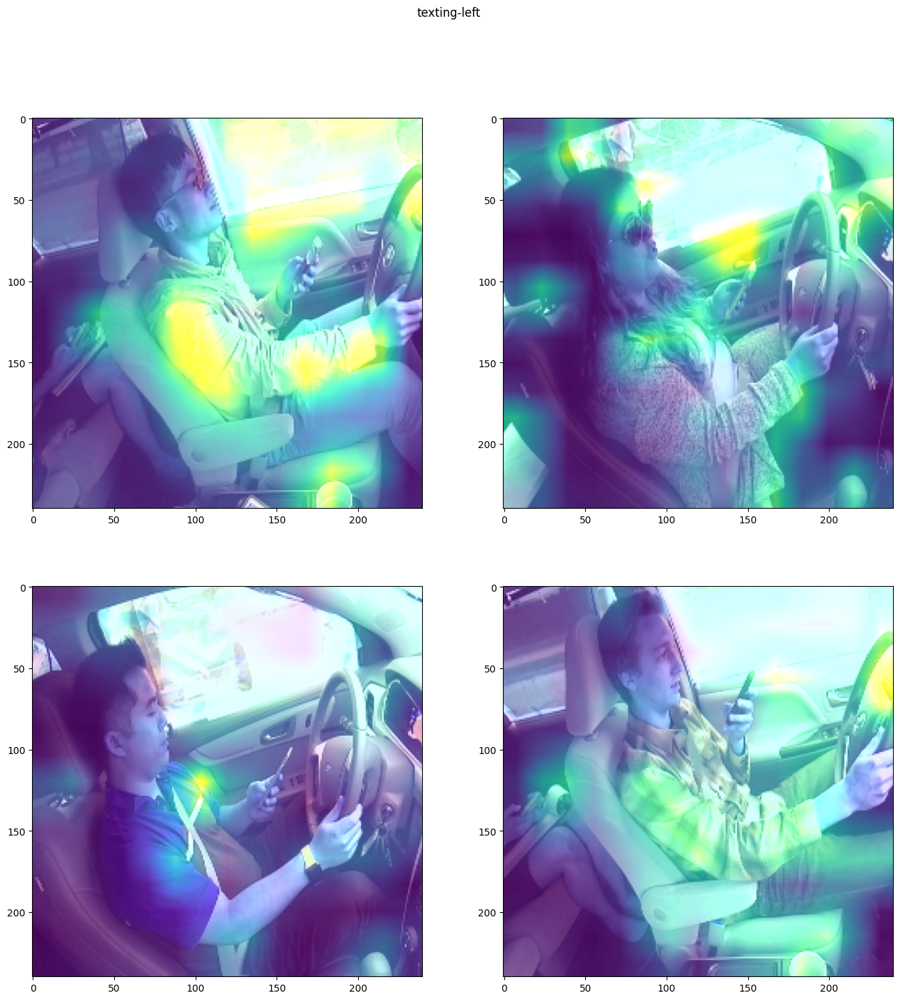

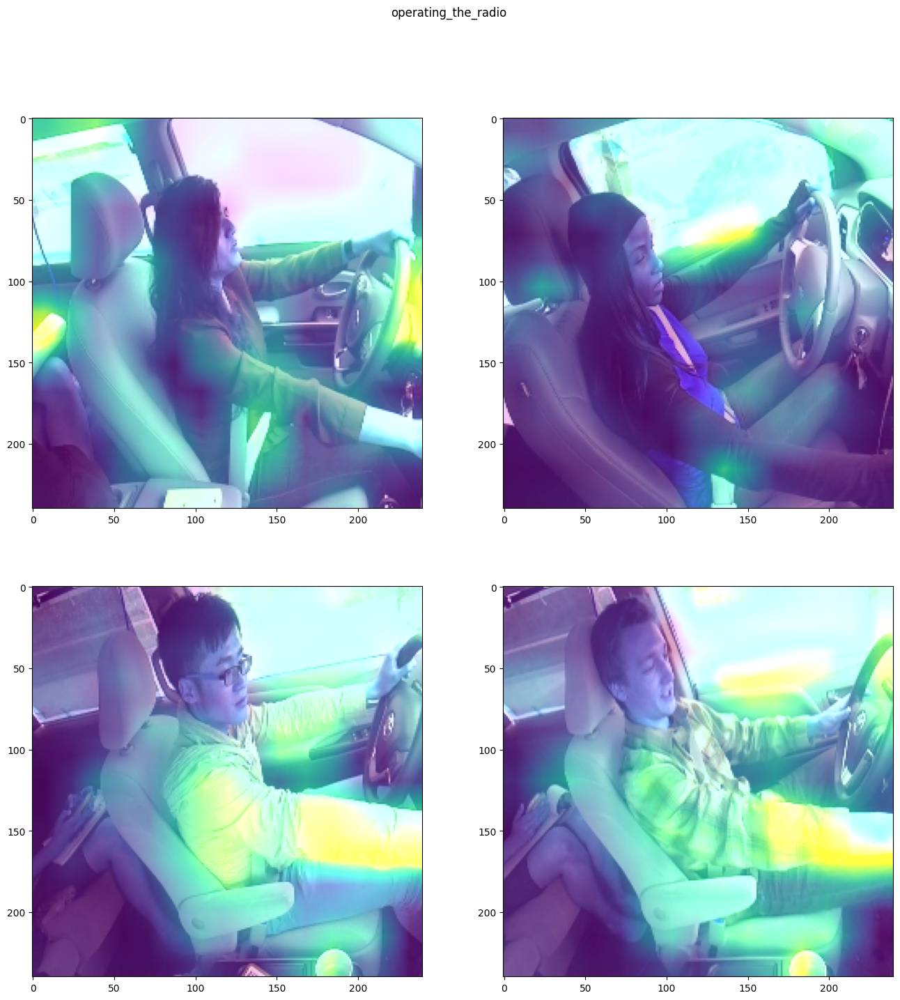

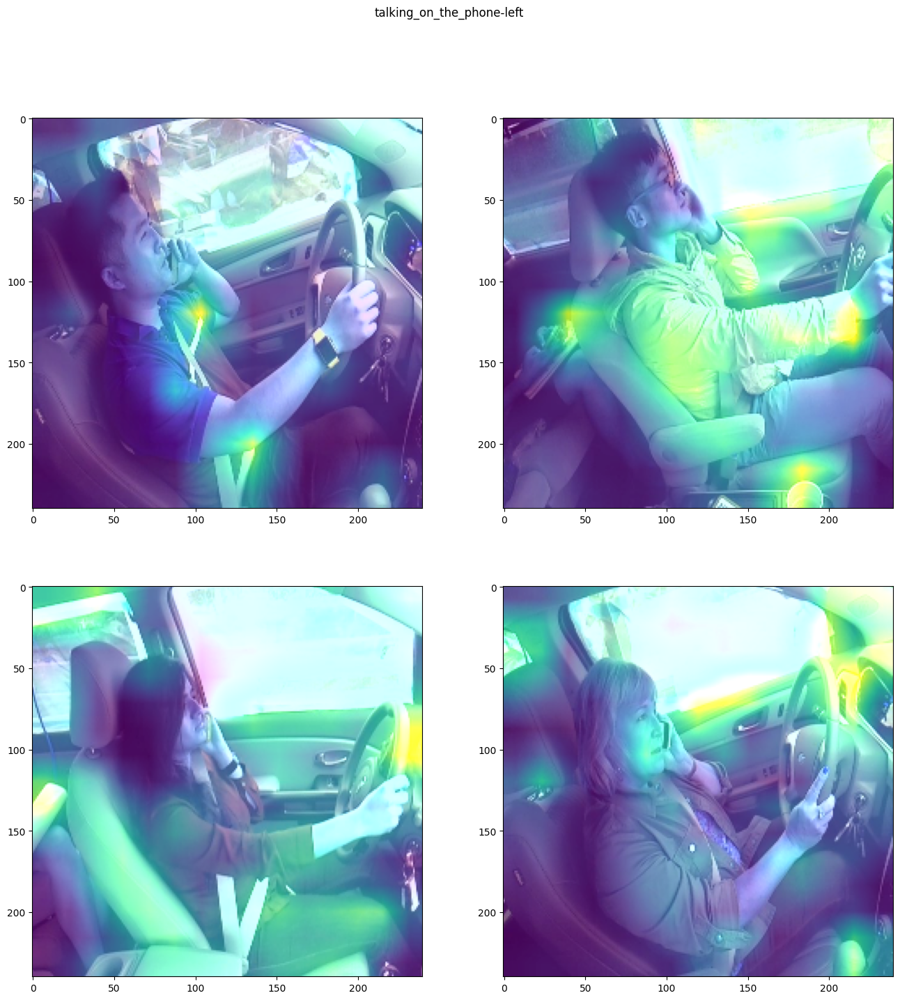

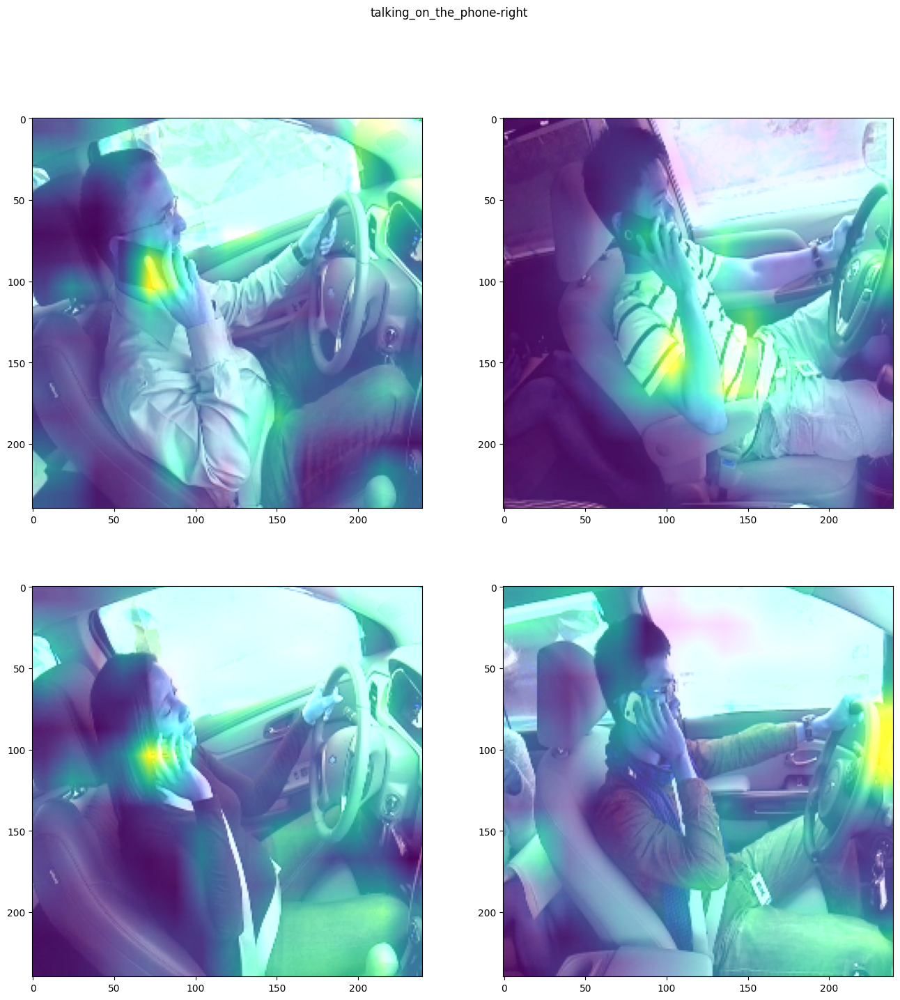

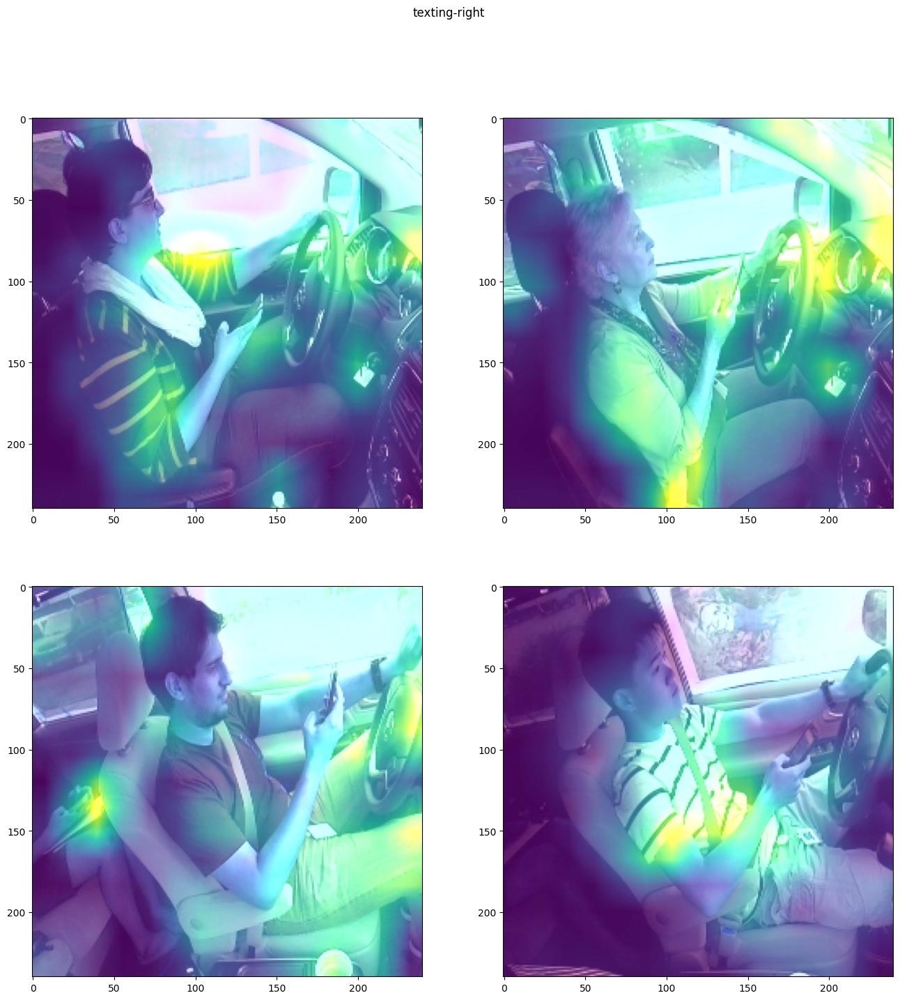

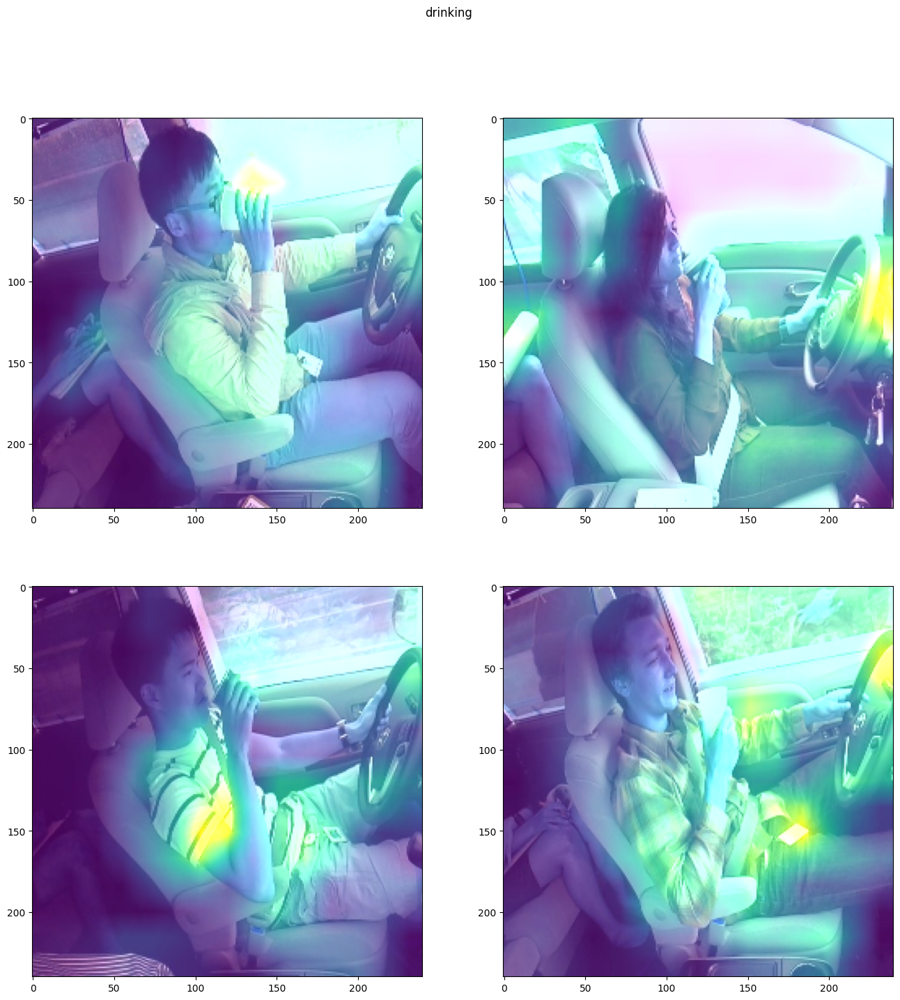

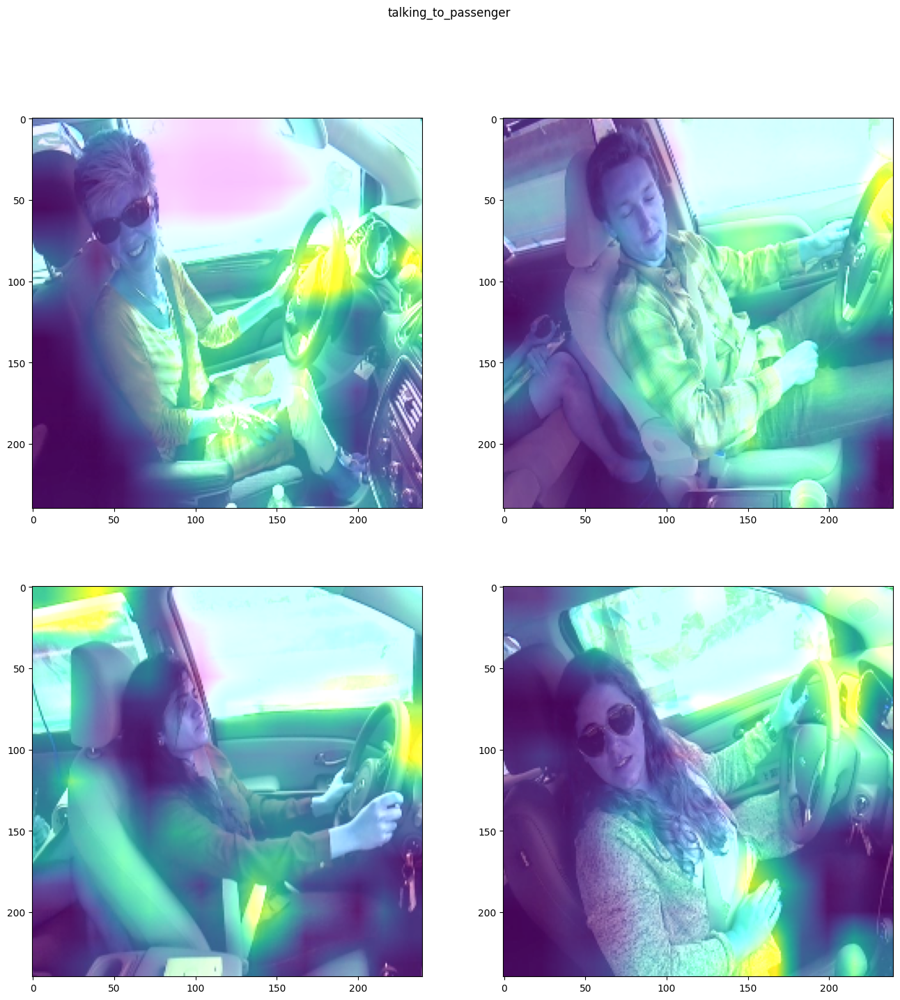

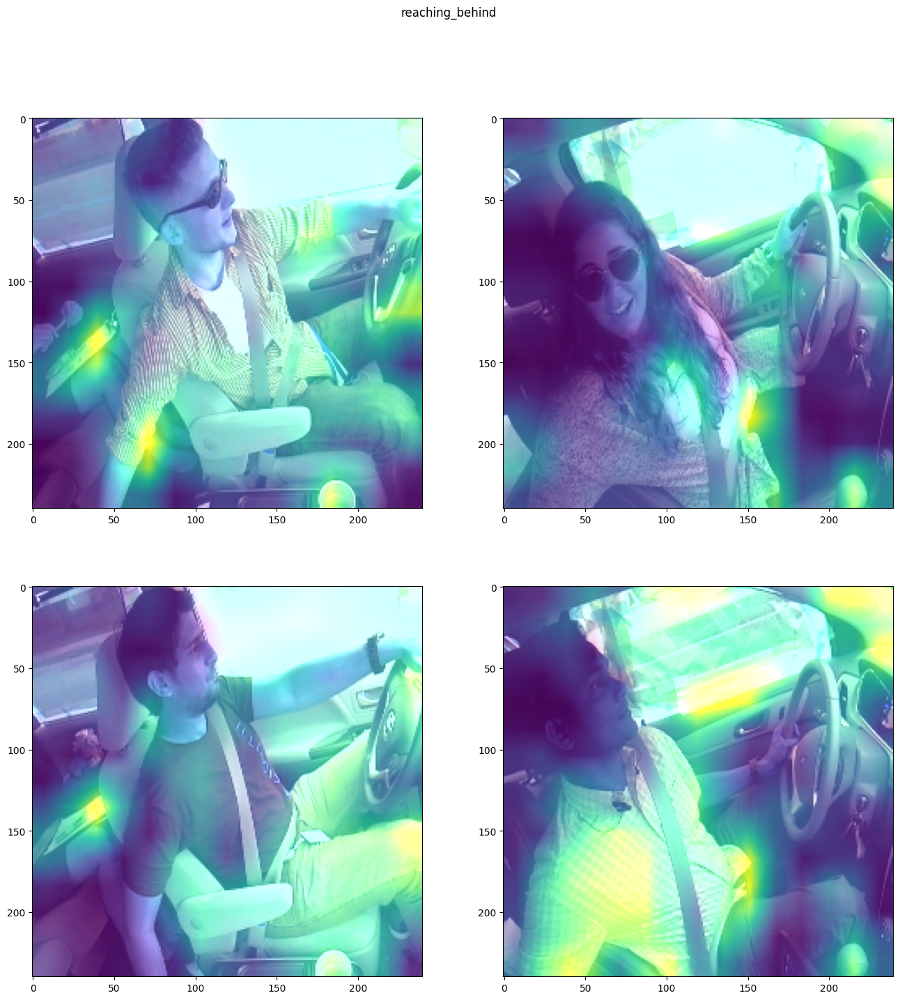

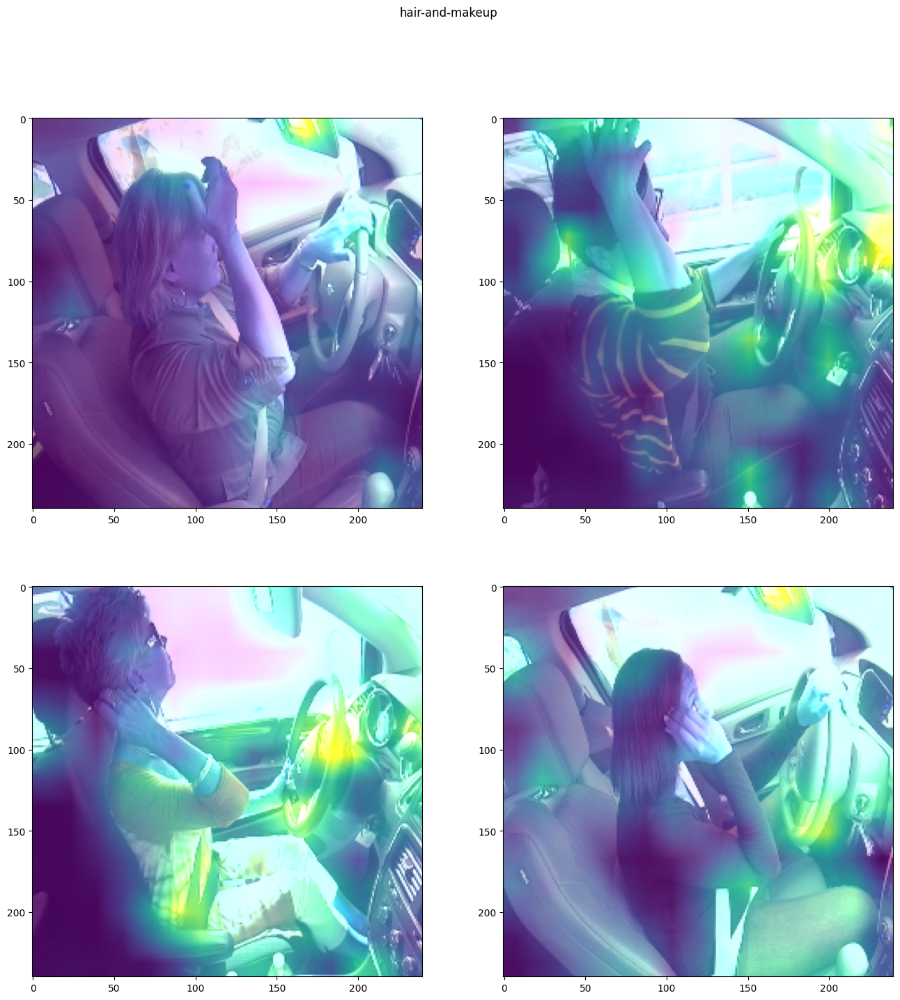

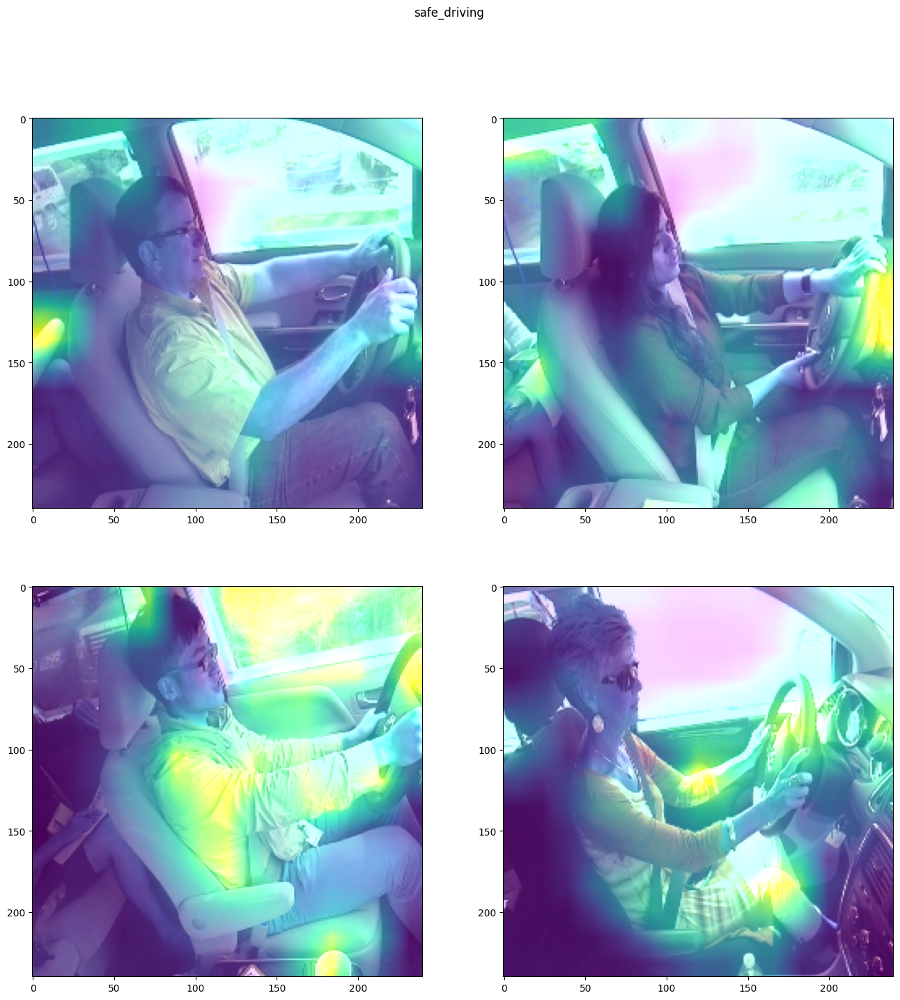

In [ ]:
for class_name in X_test['classname'].unique():
    grad_cam(model, X_test, class_name, dict_class[class_name], (240,240))

In [ ]:
model_filename = 'cnn_1.h5'
model.save(model_filename)

In [ ]:
test_loss, test_accuracy = model.evaluate(validationGenerator_cnn, verbose=1)

# Print the test accuracy
print("Test Accuracy:", test_accuracy)

21/21 [==============================] - 13s 587ms/step - loss: 0.0949 - accuracy: 0.9702
Test Accuracy: 0.9702380895614624


In [ ]:
y_count=len(df_train['classname'].unique())
y_count

10

In [ ]:
resNet50 = ResNet50(include_top = False, input_shape = (560,560,3), weights = 'imagenet')

# training of all the convolution is set to false
for layer in resNet50.layers:
    layer.trainable = False

x = GlobalAveragePooling2D()(resNet50.output)
predictions = Dense(y_count, activation='softmax')(x)

model_resNet50 = Model(inputs = resNet50.input, outputs = predictions)


94765736/94765736 [==============================] - 1s 0us/step


In [ ]:
model_resNet50.compile(loss='categorical_crossentropy', optimizer="adam", metrics=['accuracy'])
rlrp_resNet50 = tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss",factor=0.01,patience=2,verbose=2,mode="auto",min_delta=0.0001,cooldown=0,min_lr=0)
model_resNet50.summary()

Model: "model_40"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 560, 560, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 566, 566, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 280, 280, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

In [ ]:
train_generator_resnet50 = datagen.flow_from_dataframe(
        X_train,  # This is the source directory for training images
        x_col='path',
        y_col='classname',
        target_size=(560, 560),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
        preprocessing_function=preprocess_input
)

val_generator_resnet50 = datagen.flow_from_dataframe(
        X_test,  # This is the source directory for training images
        x_col='path',
        y_col='classname',
        target_size=(560, 560),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
        preprocessing_function=preprocess_input
)

Found 7848 validated image filenames belonging to 10 classes.
Found 3364 validated image filenames belonging to 10 classes.


In [ ]:
history_resNet50 = model_resNet50.fit(
      train_generator_resnet50,
     validation_data=val_generator_resnet50,
      epochs=10,
       callbacks = [rlrp_resNet50],
      verbose=2)

KeyboardInterrupt: ignored

In [ ]:
width = 560
height = 560
input_shape = (height, width, 3)
conv_base = Net(weights='imagenet', include_top=False, input_shape=input_shape)

In [ ]:
train_generator = datagen.flow_from_dataframe(
        X_train,  # This is the source directory for training images
        x_col='path',
        y_col='classname',
        target_size=(height, width),
        batch_size=32,
        shuffle=True,
        # Since we use categorical_crossentropy loss, we need categorical labels
        class_mode='categorical')

validation_generator = datagen.flow_from_dataframe(
        X_test,  # This is the source directory for training images
        x_col='path',
        y_col='classname',
        target_size=(height, width),
        batch_size=32,
        shuffle=True,
        class_mode='categorical')
train_generator.class_indices

In [ ]:
conv_base.trainable = False

In [ ]:
inputs = tf.keras.layers.Input(shape=(224, 224, 3))
model = tf.keras.applications.efficientnet.EfficientNetB3(include_top=False, weights='imagenet', input_tensor=inputs)
x = tf.keras.layers.GlobalAveragePooling2D()(model.output)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.Dropout(0.2)(x)
outputs = tf.keras.layers.Dense(units=10, activation=tf.keras.activations.softmax)(x)
model = tf.keras.Model(inputs, outputs)
model.compile(optimizer=tf.optimizers.Adam(learning_rate=1e-4),loss= tf.keras.losses.CategoricalCrossentropy(),metrics=['accuracy','Recall'],
    )


In [ ]:
model.add(layers.GlobalMaxPooling2D(name="gap"))
model.add(layers.Flatten(name="flatten"))
if dropout_rate > 0:
    model.add(layers.Dropout(dropout_rate, name="dropout_out"))
#model.add(layers.Dense(256, activation='relu', name="fc1"))
model.add(layers.Dense(3, activation='softmax', name="fc_out"))

In [ ]:
model.summary()

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer="adam", metrics=['accuracy'])

In [ ]:
history_efficientNet = model.fit(
      train_generator,
      steps_per_epoch= 32,
      epochs=10,
      validation_data=validation_generator)